In [2]:
import numpy as np
import matplotlib.pyplot as plt
import librosa as lr
from IPython.display import Audio

# "Winding Machine"

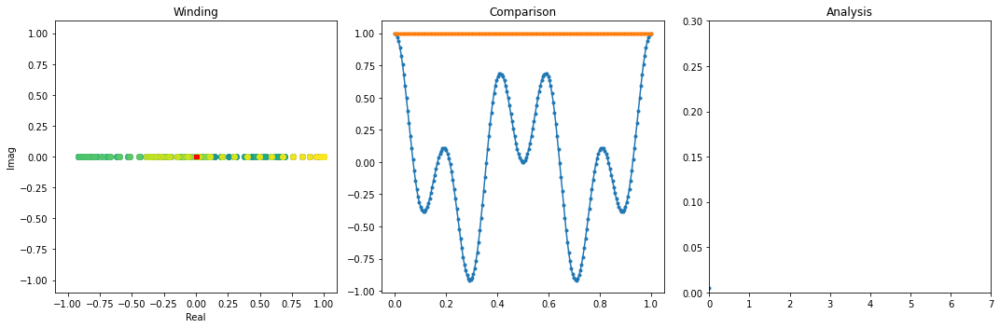

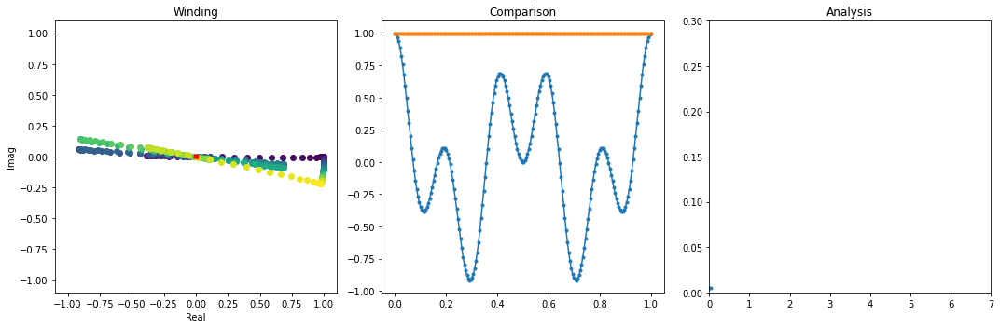

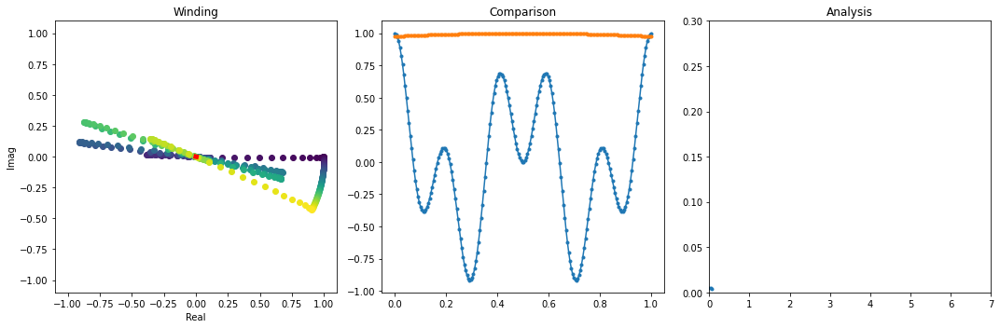

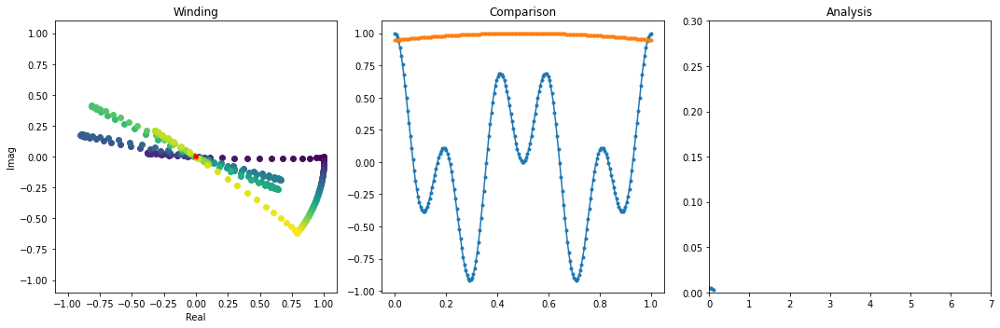

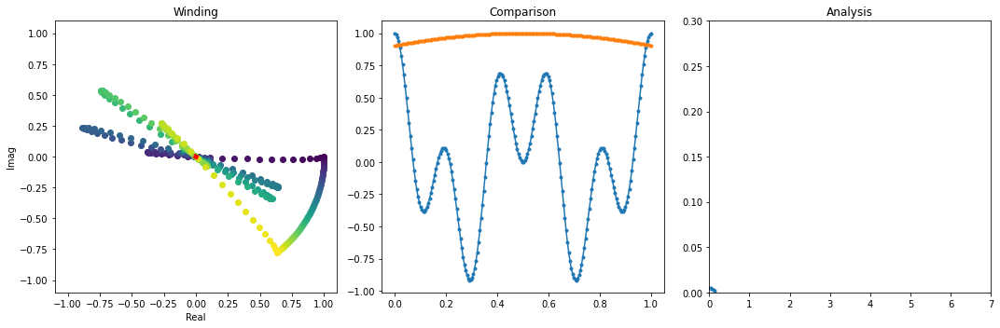

...

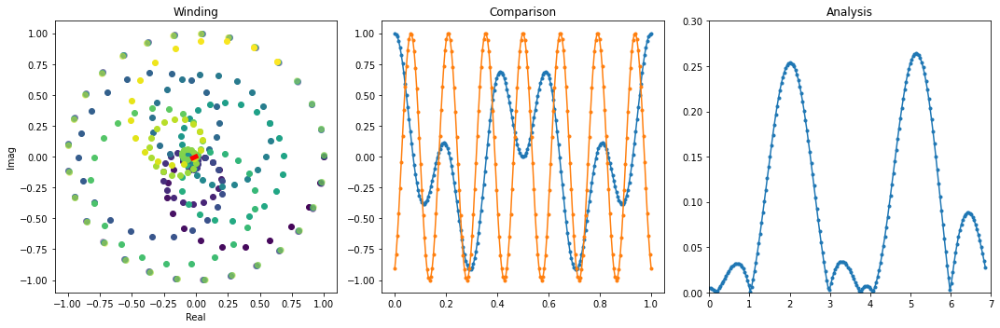

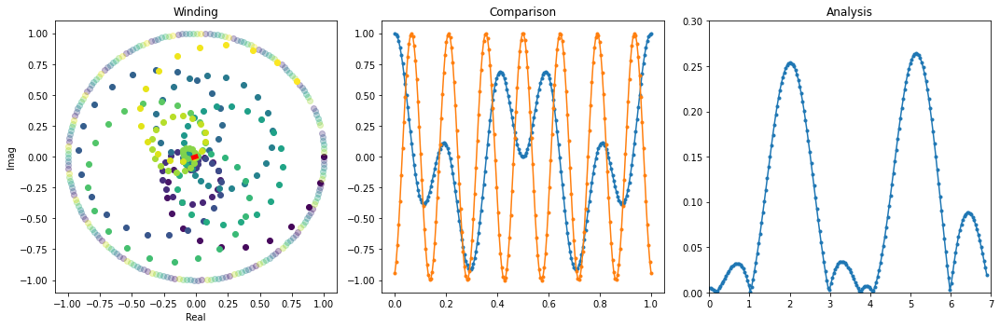

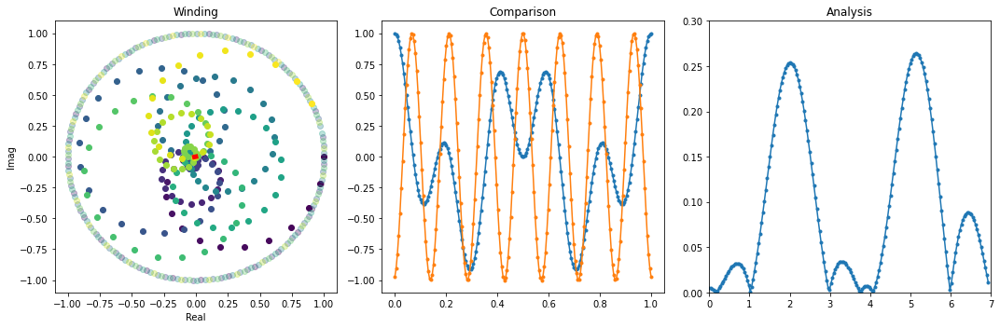

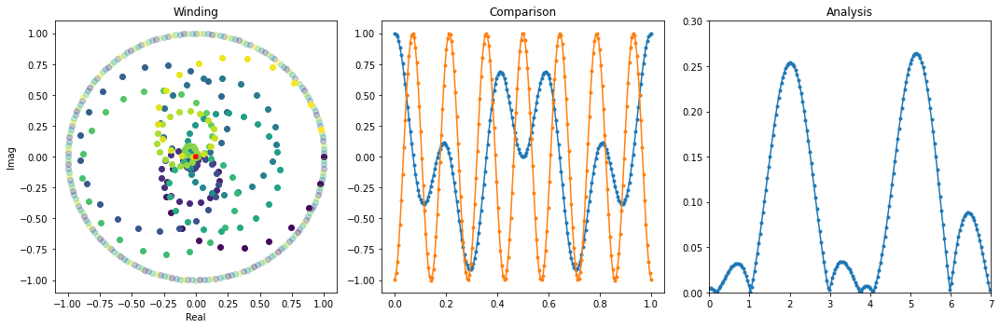

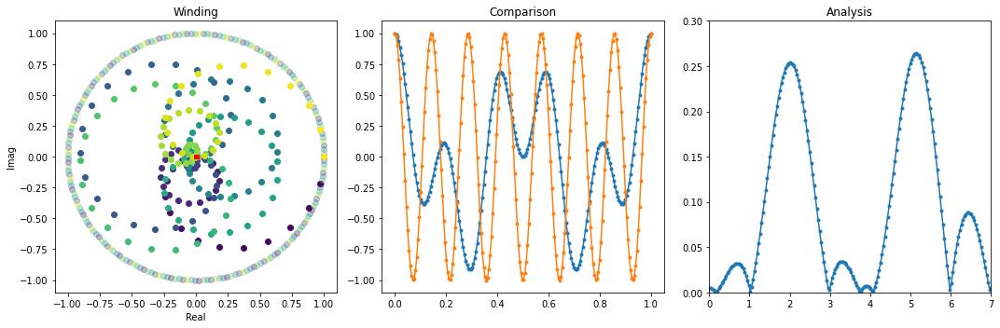

In [3]:
sr = 200
t = np.linspace(0, 1, sr)

x_phase = np.pi / 2
freq1, freq2 = 2, 5
x = (np.sin(t * 2 * np.pi * freq1 + x_phase) + np.sin(t * 2 * np.pi * freq2 + x_phase)) * 0.5
# x = np.sin(t * 2 * np.pi * freq2) * 0.25 + 0.5

winding_freqs = np.linspace(0, 7, sr)

winding_analysis = np.array([])

for i, winding_freq in enumerate(winding_freqs):

    e = np.exp(t * 2 * np.pi * 1j * -1 * winding_freq)

    winded = x * e

    gravity = np.mean(winded)

    gravity_length = np.sqrt(gravity.real ** 2 + gravity.imag ** 2)
    winding_analysis = np.append(winding_analysis, gravity_length)

    phase = np.angle(gravity)
    x_compare = np.cos(t * 2 * np.pi * winding_freq + phase)

    
    ################################################################################
    # plot
    plt.figure(figsize=(5 * 3, 5))
    p1 = plt.subplot(1, 3, 1)
    p2 = plt.subplot(1, 3, 2)
    p3 = plt.subplot(1, 3, 3)
    p1.set_title('Winding')
    p1.set_xlabel('Real')
    p1.set_ylabel('Imag')
    p2.set_title('Comparison')
    p3.set_title('Analysis')
    cm = plt.cm.get_cmap('viridis')

    lim = 1.1
    p1.set_xlim(-lim, lim)
    p1.set_ylim(-lim, lim)
    for color, ex, tx, windedx in zip(cm(t), e, t, winded):
        p1.plot(windedx.real, windedx.imag, 'o', color=color)
        circ_color = color.copy()
        circ_color[3] = 0.3
        p1.plot(ex.real, ex.imag, 'o', color=circ_color)
    p1.plot([0, gravity.real], [0, gravity.imag], color=[1, 0, 0, 1], linewidth=5)

    p2.plot(t, x, '.-')
    p2.plot(t, x_compare, '.-')

    p3.plot(winding_freqs[0:winding_analysis.size], winding_analysis, '.-')
    p3.set_xlim(winding_freqs[0], winding_freqs[-1])
    p3.set_ylim(0, 0.3)

    plt.tight_layout()
    
#     plt.savefig('./anim/winding_machine_%03d.png' % (i))
    plt.show()

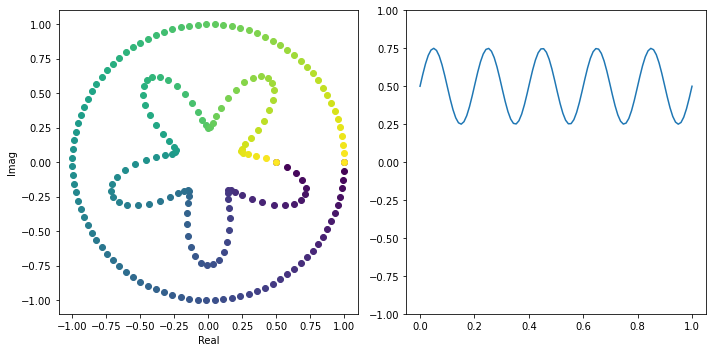

In [4]:
# erklärung "Signal um den Kreis winden"
sr = 100
t = np.linspace(0, 1, sr)

freq = 5
x = np.sin(t * 2 * np.pi * freq) * 0.25 + 0.5

e = np.exp(t * 2 * np.pi * 1j * -1 * 1)

winded = x * e

plt.figure(figsize=(5 * 2, 5))
p1 = plt.subplot(1, 2, 1)
p2 = plt.subplot(1, 2, 2)
# p1.set_title('Komplex')
p1.set_xlabel('Real')
p1.set_ylabel('Imag')
# p2.set_title('Imag')
# p3.set_title('Real')
cm = plt.cm.get_cmap('viridis')

lim = 1.1
p1.set_xlim(-lim, lim)
p1.set_ylim(-lim, lim)
for color, ex, tx, windedx in zip(cm(t), e, t, winded):
    p1.plot(windedx.real, windedx.imag, 'o', color=color)
    p1.plot(ex.real, ex.imag, 'o', color=color)

p2.plot(t, x)
p2.set_ylim(-1, 1)

plt.tight_layout()

# DFT Diskrete Fourier Transformation

${\displaystyle X_k =\sum_{n = 0}^{N - 1} \left( x_n \cdot e^{-{\frac {2 \pi i k n}{N}}} \right)}$

$\left\{X_{k} \right\} := X_{0}, X_{1}, \ldots, X_{N-1}$

$x_n$ ist bei uns `x`

$n$ ist ein Zeitindex; bei uns `t`

$X_k$ ist bei uns `winding_analysis`

$k$ ist der Frequenz-Index (also nicht die Frequenz in Hz), d.h. bei uns  die Indizes von `winding_freqs`

$N$ ist gleichzeitig der letzte Zeitindex, wie auch der letzte Frequenz-Index

## Begriffsunterscheidung

Fourier Transform

Discrete Fourier Transform

FFT Fast Fourier Transform --> DFT (nur ein schneller Algorithmus um die DFT zu berechnen)

------

STFT: Short Time Fourier Transform 